In [1]:
import pandas as pd
import numpy as np

## Data Loading, Understanding, Cleaning

In [2]:
df = pd.read_csv("loan.csv")
df.head()

C:\Users\nkothapalli\AppData\Roaming\Python\Python39\site-packages\IPython\core\interactiveshell.py:3169: DtypeWarning: Columns (47) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


- It seems there is no problem with the header rows, they are all correctly named
- Let's check for footer/summary rows

In [3]:
df.tail()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
39712,92187,92174,2500,2500,1075.0,36 months,8.07%,78.42,A,A4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39713,90665,90607,8500,8500,875.0,36 months,10.28%,275.38,C,C1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39714,90395,90390,5000,5000,1325.0,36 months,8.07%,156.84,A,A4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39715,90376,89243,5000,5000,650.0,36 months,7.43%,155.38,A,A2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39716,87023,86999,7500,7500,800.0,36 months,13.75%,255.43,E,E2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


- They are good as well, let's check for empty rows (rows with all nulls)

In [4]:
print(df.shape)
df.dropna(axis=0, how='all', inplace=True)
print(df.shape)

(39717, 111)
(39717, 111)


- So, there are not any rows with all missing values!

Let's check the same for the columns!

In [5]:
df.notnull().sum().sort_values()

verification_status_joint        0
bc_util                          0
bc_open_to_buy                   0
avg_cur_bal                      0
acc_open_past_24mths             0
                             ...  
application_type             39717
delinq_2yrs                  39717
dti                          39717
zip_code                     39717
id                           39717
Length: 111, dtype: int64

Seems there are quite a few columns with all missing values. Let's verify and remove them!

In [6]:
df.loc[:, df.notnull().sum()==0]

,mths_since_last_major_derog,annual_inc_joint,dti_joint,verification_status_joint,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,...,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39713,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39714,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39715,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
df = df.loc[:, df.notnull().sum()>0]
print(df.shape)

(39717, 57)


Let's again repeat the process to see if there are columns with a lot of missings

In [8]:
df.notnull().sum().sort_values()

next_pymnt_d                   1140
mths_since_last_record         2786
mths_since_last_delinq        14035
desc                          26777
emp_title                     37258
emp_length                    38642
pub_rec_bankruptcies          39020
last_pymnt_d                  39646
chargeoff_within_12_mths      39661
collections_12_mths_ex_med    39661
revol_util                    39667
tax_liens                     39678
title                         39706
last_credit_pull_d            39715
home_ownership                39717
out_prncp_inv                 39717
total_pymnt                   39717
total_pymnt_inv               39717
total_rec_prncp               39717
total_rec_int                 39717
total_rec_late_fee            39717
recoveries                    39717
collection_recovery_fee       39717
last_pymnt_amnt               39717
out_prncp                     39717
funded_amnt                   39717
loan_amnt                     39717
policy_code                 

There are 4 columns with a lot of missing values still!

- Still, 'next_pymnt_d', 'mths_since_last_record' and 'mths_since_last_delinq' have a lot of missing values.
- We may replace missing values of 'mths_since_last_delinq' to be zero. But that could exaggerate the issue.
- So, dropping these 3 columns as well.
- Though, 'desc' also has a lot of missing values, it is neither categorical nor numeric, we can just replace missing with "NA" string

In [21]:
drop_cols = ["next_pymnt_d", "mths_since_last_record", "mths_since_last_delinq"]
df.drop(drop_cols, axis=1, inplace=True)

In [22]:
df['desc'] = df['desc'].fillna("NA")

In [23]:
df['desc']

0          Borrower added on 12/22/11 > I need to upgra...
1          Borrower added on 12/22/11 > I plan to use t...
2                                                       NA
3          Borrower added on 12/21/11 > to pay for prop...
4          Borrower added on 12/21/11 > I plan on combi...
                               ...                        
39712    Our current gutter system on our home is old a...
39713    The rate of interest and fees incurred by carr...
39714                                                   NA
39715                                                   NA
39716    I plan to consolidate over $7,000 of debt: a c...
Name: desc, Length: 39717, dtype: object

The missing values in other columns are not very significant and we impute them after cleaning the column first.

### Identifying meanings of Columns and Fixing Column Formats

In [9]:
data_dictionary = pd.read_excel("Data_Dictionary.xlsx")

# remove those columns which are full of null-values in the data dictionary
data_dictionary = data_dictionary.loc[:, data_dictionary.notnull().sum()!=0]

# align data dictionary in the order of df columns
data_dictionary = data_dictionary.set_index('LoanStatNew')
common_cols = set(df.columns).intersection(data_dictionary.index)
missing_cols_in_data_dict = set(df.columns) - set(data_dictionary.index)
print(f"{missing_cols_in_data_dict=}")

data_dictionary = data_dictionary.loc[list(common_cols)]

with pd.option_context("display.width", 1000, "display.max_columns", 50, "display.max_colwidth", 100):
    print(data_dictionary)

missing_cols_in_data_dict=set()
                                                                                                                    Description
LoanStatNew                                                                                                                    
int_rate                                                                                              Interest Rate on the loan
loan_status                                                                                          Current status of the loan
total_acc                                              The total number of credit lines currently in the borrower's credit file
inq_last_6mths                                 The number of inquiries in past 6 months (excluding auto and mortgage inquiries)
loan_amnt                   The listed amount of the loan applied for by the borrower. If at some point in time, the credit ...
last_credit_pull_d                                                      

#### To understand data more easily, we break down columns into samples and go through respective data dictionary in batches of 10

In [10]:
from pprint import pprint
for i in range(0, len(df.columns), 10):
    col_sample = df.columns[i:i+10]
    with pd.option_context("display.width", 1000, "display.max_columns", 50, "display.max_colwidth", 100):
        print(data_dictionary.loc[col_sample])
    pprint(data_dictionary.loc[col_sample].to_dict())
    print(df[col_sample])
    print(df[col_sample].dtypes)
    print("\n\n\n")
    

                                                                                                         Description
id                                                                     A unique LC assigned ID for the loan listing.
member_id                                                           A unique LC assigned Id for the borrower member.
loan_amnt        The listed amount of the loan applied for by the borrower. If at some point in time, the credit ...
funded_amnt                                           The total amount committed to that loan at that point in time.
funded_amnt_inv                         The total amount committed by investors for that loan at that point in time.
term                            The number of payments on the loan. Values are in months and can be either 36 or 60.
int_rate                                                                                   Interest Rate on the loan
installment                                         The monthly 

[39717 rows x 10 columns]
open_acc                 int64
pub_rec                  int64
revol_bal                int64
revol_util              object
total_acc                int64
initial_list_status     object
out_prncp              float64
out_prncp_inv          float64
total_pymnt            float64
total_pymnt_inv        float64
dtype: object




                                                                                 Description
total_rec_prncp                                                   Principal received to date
total_rec_int                                                      Interest received to date
total_rec_late_fee                                                Late fees received to date
recoveries                                                    post charge off gross recovery
collection_recovery_fee                                       post charge off collection fee
last_pymnt_d                                                 Last month payment was rece

#### Meanings of the Difficult Terms:

- pub_rec: 'Number of derogatory public records' - these are bankruptcy information available from the courts 
(src: https://www.experian.com/blogs/ask-experian/meaning-of-derogatory-public-record/#:~:text=A%20derogatory%20item%20is%20an,were%20not%20paid%20as%20agreed.)

- delinquent - this means missing out on the due date
- bankruptcy - typically, the situation where the borrower would not repay the loan

- revol_bal: 'Total credit revolving balance'
- revol_util: 'Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.'

- 'chargeoff_within_12_mths': 'Number of charge-offs within 12 months' - charge-off is writing off as a loss

- A tax lien is a claim the government makes on a property when the owner fails to pay the property taxes(Src: Investopedia)

#### Points to be Noted:

- Although 'term' is numeric, since there are months at the end, it would be considered categorical - changing format
- Similarly, 'int_rate' (interest rate), revol_util(utilization% of available credit) should be made numeric by removing % at the end
- issue_d, earliest_cr_line, last_pymnt_d, next_pymnt_d, last_credit_pull_d to be converted to date type
- 'emp_length' can be converted to numeric (int) type

In [15]:
month_suffix = " months"
percent_suffix = "%"

df.loc[:,'term'] = df.loc[:,'term'].apply(lambda x: x[:-len(month_suffix)] if str(x).endswith(month_suffix) else x).astype(np.int32)
df.loc[:,'int_rate'] = df.loc[:,'int_rate'].apply(lambda x: x[:-len(percent_suffix)] if str(x).endswith(percent_suffix) else x).astype(np.float64)
df.loc[:,'revol_util'] = df.loc[:,'revol_util'].apply(lambda x: x[:-len(percent_suffix)] if str(x).endswith(percent_suffix) else x).astype(np.float64)

df[['term', 'int_rate', 'revol_util']]

,term,int_rate,revol_util
0,36,10.65,83.7
1,60,15.27,9.4
2,36,15.96,98.5
3,36,13.49,21.0
4,60,12.69,53.9
...,...,...,...
39712,36,8.07,13.1
39713,36,10.28,26.9
39714,36,8.07,19.4
39715,36,7.43,0.7


In [32]:
date_cols = "last_pymnt_d, last_credit_pull_d, issue_d, earliest_cr_line".split(", ")
for date_col in date_cols:
    df[date_col] = pd.to_datetime(df[date_col], format="%b-%y", errors='coerce')
    print(df[date_col].median())
    print(df[date_col].mode())    

2013-04-01 00:00:00
0   2016-05-01
dtype: datetime64[ns]
2015-03-01 00:00:00
0   2016-05-01
dtype: datetime64[ns]
2011-02-01 00:00:00
0   2011-12-01
dtype: datetime64[ns]
1998-05-01 00:00:00
0   1998-11-01
dtype: datetime64[ns]


Let's look if all the date columns are well formatted

In [100]:
for date_col in date_cols:
    print(date_col)
    print(df[date_col].dt.year.value_counts())

last_pymnt_d
2013    9529
2014    9269
2012    8904
2011    4996
2015    2431
2016    2044
2010    1848
2009     559
2008     137
Name: last_pymnt_d, dtype: int64
last_credit_pull_d
2016    15371
2014     6255
2015     5504
2013     5164
2012     4079
2011     2191
2010      848
2009      228
2008       41
2007       36
Name: last_credit_pull_d, dtype: int64
issue_d
2011    21656
2010    11532
2009     4716
2008     1562
2007      251
Name: issue_d, dtype: int64
earliest_cr_line
2000    3250
1999    2968
1998    2851
2001    2521
1997    2456
1996    2274
1995    2150
1994    2027
2002    1927
2003    1856
2004    1761
1993    1514
2005    1493
2006    1169
1992    1063
1990    1038
1991     980
1989     861
1988     740
2007     712
1987     618
1986     500
1985     461
1984     409
1983     338
1982     224
1981     187
1980     180
1979     165
1978     165
2008     159
1977     115
1976      97
1975      83
1973      66
1974      65
1972      53
1970      48
1971      46
1969     

Clearly some values in 'earliest_cr_line' have years which are greater than present year. This could be because the dates have years in (yy rather than yyyy) format.

In [106]:
present_year = 2022
date_mask = (df['earliest_cr_line'].dt.year>present_year)
df.loc[date_mask, 'earliest_cr_line'] = df.loc[date_mask, 'earliest_cr_line'] - pd.DateOffset(years=100)
df['earliest_cr_line'].dt.year.unique()

array([1985, 1999, 2001, 1996, 2004, 2005, 2007, 1998, 1989, 2003, 1991,
       1993, 1997, 1983, 2002, 1984, 2006, 1987, 1981, 2000, 1994, 1995,
       1992, 1986, 1990, 1988, 1980, 2008, 1973, 1979, 1982, 1978, 1971,
       1972, 1970, 1969, 1975, 1976, 1977, 1962, 1968, 1974, 1964, 1967,
       1965, 1963, 1954, 1966, 1959, 1956, 1946, 1950, 1961], dtype=int64)

Formatting 'emp_length' column

In [60]:
df['emp_length'].unique()

array(['10+ years', '< 1 year', '1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '6 years', '2 years', '7 years', nan],
      dtype=object)

In [61]:
map_vals = \
    dict(
        zip(
            ['10+ years', '< 1 year', '1 year', '3 years', '8 years', '9 years','4 years', '5 years', '6 years', '2 years', '7 years'],
            [10, 0, 1, 3, 8, 9, 4, 5, 6, 2, 7]
    ))
map_vals

{'10+ years': 10,
 '< 1 year': 0,
 '1 year': 1,
 '3 years': 3,
 '8 years': 8,
 '9 years': 9,
 '4 years': 4,
 '5 years': 5,
 '6 years': 6,
 '2 years': 2,
 '7 years': 7}

In [66]:
df['emp_length'] = df['emp_length'].map(map_vals).astype("Int64")
df['emp_length'].unique()

<IntegerArray>
[10, 0, 1, 3, 8, 9, 4, 5, 6, 2, 7, <NA>]
Length: 12, dtype: Int64

#### Imputing the missing Values

We observe that the date columns have only a few missing values, these can be imputed by median. Median is close to mode in this case and occurring earlier. So, we may use it as a consevative estimate.

In [43]:
for date_col in date_cols:
    df[date_col] = df[date_col].fillna(df[date_col].median())
df[date_cols].isnull().sum()

last_pymnt_d          0
last_credit_pull_d    0
issue_d               0
earliest_cr_line      0
dtype: int64

Now that str(not categorical but text type) and date columns are imputed, let's impute int and str cols using mode, numeric ones using median

In [67]:
dtypes = df.dtypes
dtypes

id                                     int64
member_id                              int64
loan_amnt                              int64
funded_amnt                            int64
funded_amnt_inv                      float64
term                                   int32
int_rate                             float64
installment                          float64
grade                                 object
sub_grade                             object
emp_title                             object
emp_length                             Int64
home_ownership                        object
annual_inc                           float64
verification_status                   object
issue_d                       datetime64[ns]
loan_status                           object
pymnt_plan                            object
url                                   object
desc                                  object
purpose                               object
title                                 object
zip_code  

In [50]:
float_type_cols = dtypes[dtypes==float].index
float_type_cols

Index(['funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti',
       'revol_util', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_amnt', 'collections_12_mths_ex_med',
       'chargeoff_within_12_mths', 'pub_rec_bankruptcies', 'tax_liens'],
      dtype='object')

In [52]:
# those float cols which need imputation
float_type_cols = float_type_cols[(df[float_type_cols].isnull().sum()>0)]
float_type_cols

Index(['revol_util', 'collections_12_mths_ex_med', 'chargeoff_within_12_mths',
       'pub_rec_bankruptcies', 'tax_liens'],
      dtype='object')

In [55]:
df[float_type_cols] = df[float_type_cols].fillna(df[float_type_cols].median(axis=0))
df[float_type_cols].isnull().sum()

revol_util                    0
collections_12_mths_ex_med    0
chargeoff_within_12_mths      0
pub_rec_bankruptcies          0
tax_liens                     0
dtype: int64

Let's impute the remaining categorical and int type columns with mode


In [68]:
imputation_cols = dtypes[df.isnull().sum()>0]
imputation_cols

emp_title     object
emp_length     Int64
title         object
dtype: object

In [76]:
for col in imputation_cols.index:
    df[col] = df[col].fillna(df[col].mode().iloc[0])
df[imputation_cols.index].isnull().sum()

emp_title     0
emp_length    0
title         0
dtype: int64

In [77]:
dtypes[(df.isnull().sum()>0)]

Series([], dtype: object)

All the values are imputed now!

#### Removing columns with too few or too many unique values

In [83]:
print(df.shape)
nuniques = df.nunique().sort_values()
nuniques

(39717, 54)


tax_liens                         1
delinq_amnt                       1
chargeoff_within_12_mths          1
acc_now_delinq                    1
application_type                  1
policy_code                       1
initial_list_status               1
collections_12_mths_ex_med        1
pymnt_plan                        1
term                              2
pub_rec_bankruptcies              3
verification_status               3
loan_status                       3
pub_rec                           5
home_ownership                    5
grade                             7
inq_last_6mths                    9
emp_length                       11
delinq_2yrs                      11
purpose                          14
sub_grade                        35
open_acc                         40
addr_state                       50
issue_d                          55
total_acc                        82
last_pymnt_d                    101
last_credit_pull_d              106
int_rate                    

Clearly, columns with single unique value does not add information to the analysis. Removing them...

In [85]:
single_unique_val_cols = nuniques[nuniques==1].index
df[single_unique_val_cols]

,tax_liens,delinq_amnt,chargeoff_within_12_mths,acc_now_delinq,application_type,policy_code,initial_list_status,collections_12_mths_ex_med,pymnt_plan
0,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
1,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
2,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
3,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
4,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
...,...,...,...,...,...,...,...,...,...
39712,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
39713,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
39714,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n
39715,0.0,0,0.0,0,INDIVIDUAL,1,f,0.0,n


Removing the following cols as they have only 1 unique value:
- tax_liens(govt. claim on property for tax default), 
- delinq_amnt (past amount which was not paid by due date), 
- chargeoff_within_12_mths(number of wrteoffs as loss), 
- acc_now_delinq(number of delinquent accounts), 
- application_type(single or joint application), 
- policy_code(whether this is publicly available policy code), 
- initial_list_status(initial status when listed), 
- collections_12_mths_ex_med(no. of collections in 12 months excluding medical collections),
- pymnt_plan(if payment plan is in place)

In [86]:
df.drop(single_unique_val_cols, axis=1, inplace=True)
df.shape

(39717, 45)

In [222]:
# 'out_prncp_inv' also has 1 unique value
drops = ['out_prncp_inv']
df.drop(drops, inplace=True, axis=1)

In [87]:
print(df.shape)
nuniques = df.nunique().sort_values()
nuniques

(39717, 45)


term                           2
pub_rec_bankruptcies           3
loan_status                    3
verification_status            3
pub_rec                        5
home_ownership                 5
grade                          7
inq_last_6mths                 9
delinq_2yrs                   11
emp_length                    11
purpose                       14
sub_grade                     35
open_acc                      40
addr_state                    50
issue_d                       55
total_acc                     82
last_pymnt_d                 101
last_credit_pull_d           106
int_rate                     371
earliest_cr_line             526
zip_code                     823
loan_amnt                    885
funded_amnt                 1041
revol_util                  1089
out_prncp                   1137
out_prncp_inv               1138
total_rec_late_fee          1356
collection_recovery_fee     2616
dti                         2868
recoveries                  4040
annual_inc

In [94]:
df['url'].head().tolist()

['https://lendingclub.com/browse/loanDetail.action?loan_id=1077501',
 'https://lendingclub.com/browse/loanDetail.action?loan_id=1077430',
 'https://lendingclub.com/browse/loanDetail.action?loan_id=1077175',
 'https://lendingclub.com/browse/loanDetail.action?loan_id=1076863',
 'https://lendingclub.com/browse/loanDetail.action?loan_id=1075358']

Removing the following columns as well
- Since id and member_id are id columns, they are not useful for the analysis
- Even the 'url' contains id information and not very useful
- 'total_pymnt_inv' is similar to 'total_pymnt' (just that it is from investors)

In [95]:
drop_cols = ['id', 'member_id', 'url']
df.drop(drop_cols, axis=1, inplace=True)
df.shape

(39717, 42)

let's also see other cols are biased towards a single value

In [90]:
# percent of values of the most frequently occurring value for each column
# df.apply(lambda col: (col.value_counts().max())*100/len(col), axis=0).sort_values(ascending=False)

out_prncp                  97.129693
out_prncp_inv              97.129693
pub_rec_bankruptcies       95.767555
total_rec_late_fee         94.848554
pub_rec                    94.672307
collection_recovery_fee    90.477629
recoveries                 89.379863
delinq_2yrs                89.143188
loan_status                82.961956
term                       73.258302
inq_last_6mths             48.593801
home_ownership             47.584158
purpose                    46.934562
verification_status        42.603923
desc                       32.580507
grade                      30.264119
last_credit_pull_d         25.953622
emp_length                 25.062316
addr_state                 17.873958
open_acc                   10.116575
sub_grade                   7.344462
loan_amnt                   7.132966
funded_amnt                 6.901327
emp_title                   6.528690
total_rec_prncp             5.773346
issue_d                     5.690259
title                       5.526601
a

In [91]:
# cols = ['out_prncp', 'out_prncp_inv', 'pub_rec_bankruptcies', 'total_rec_late_fee', 'pub_rec', 
# 'collection_recovery_fee', 'recoveries', 'delinq_2yrs', 'loan_status', 'term']
# df[cols]

,out_prncp,out_prncp_inv,pub_rec_bankruptcies,total_rec_late_fee,pub_rec,collection_recovery_fee,recoveries,delinq_2yrs,loan_status,term
0,0.00,0.00,0.0,0.00,0,0.00,0.00,0,Fully Paid,36
1,0.00,0.00,0.0,0.00,0,1.11,117.08,0,Charged Off,60
2,0.00,0.00,0.0,0.00,0,0.00,0.00,0,Fully Paid,36
3,0.00,0.00,0.0,16.97,0,0.00,0.00,0,Fully Paid,36
4,524.06,524.06,0.0,0.00,0,0.00,0.00,0,Current,60
...,...,...,...,...,...,...,...,...,...,...
39712,0.00,0.00,0.0,0.00,0,0.00,0.00,0,Fully Paid,36
39713,0.00,0.00,0.0,0.00,0,0.00,0.00,1,Fully Paid,36
39714,0.00,0.00,0.0,0.00,0,0.00,0.00,0,Fully Paid,36
39715,0.00,0.00,0.0,0.00,0,0.00,0.00,0,Fully Paid,36


Since we are interested in loan_status, let's look at its distribution first

In [110]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

In [108]:
df['loan_status'].value_counts()

Fully Paid     32950
Charged Off     5627
Current         1140
Name: loan_status, dtype: int64

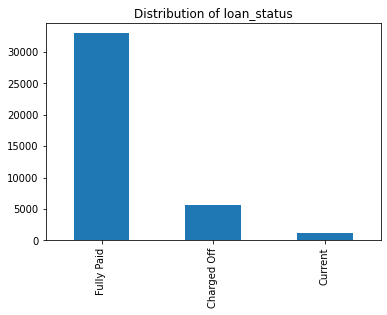

In [112]:
df['loan_status'].value_counts().plot(kind='bar', title="Distribution of loan_status")
plt.show()

Since 'Current'(loans which are being paid off) are not useful for this analysis, we are dropping this category.

In [114]:
df = df[df.loan_status!='Current']
df.shape

(38577, 42)

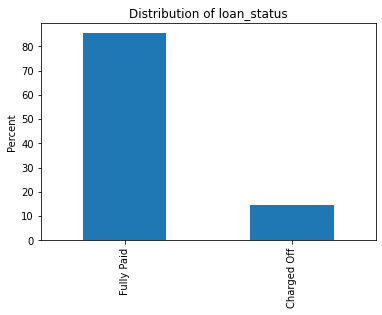

In [122]:
(df['loan_status'].value_counts(normalize=True)*100).plot(kind='bar', title="Distribution of loan_status", ylabel='Percent')
plt.show()

In [121]:
(df['loan_status'].value_counts(normalize=True)*100).round(2)

Fully Paid     85.41
Charged Off    14.59
Name: loan_status, dtype: float64

Around 15% of the loans are charged off/default.

### Univariate and Segmented Univariate

Let's plot distributions for unordered categoricals first and see if any variable is following power-law distribution

In [ ]:
unordered_categoricals = ['sub_grade', 'home_ownership',
                          'purpose', 'addr_state', 'verification_status']

In [157]:
df['verification_status'].nunique()

3

In [145]:
import plotly.graph_objects as go

def compare_distributions(var):
    dataset_distribution = (df[var].value_counts(normalize=True)*100)
    charged_off_distribution = (df.loc[df['loan_status']=='Charged Off',var].value_counts(normalize=True)*100)
    
    fig = go.Figure(
        [
            go.Bar(
                x = dataset_distribution.index,
                y = dataset_distribution.values,
                name='Dataset'
            ),
            go.Bar(
                x = charged_off_distribution.index,
                y = charged_off_distribution.values,
                name='Charged Off'
            )
        ]
    )

    fig.update_layout(
        title=f"Distribution of '{var}' (whole dataset vs 'charged off')",
        yaxis_title="Frequency (%)",
        font=dict(
            family="Courier New, monospace",
            size=18,
            color="RebeccaPurple"
        )
    )
    fig.update_xaxes(categoryorder='category ascending')

    fig.show()

In [146]:
var = 'sub_grade'
compare_distributions(var)

We can observe that there is higher chance of default(charged-off) for the lower grades.

In [147]:
compare_distributions('home_ownership')

In [155]:
compare_distributions('addr_state')

Most of the loans are sanctioned to California, Texas, Florida and NewYork. Florida has a slightly higher chance of charging off.

In [153]:
compare_distributions('purpose')

'small_business' has higher chance of default

In [158]:
compare_distributions('verification_status')

Surprisingly, those with income status verified have higher probability of charge-off!

In [160]:
compare_distributions('term')

In [166]:
compare_distributions('delinq_2yrs')

This 'delinq_2yrs' seems to be following power law distribution.

In [184]:
import plotly.express as px

def plot_power_law(var):
    distribution = df[var].value_counts().sort_values(ascending=False)
    fig = px.line(x=np.arange(1, len(distribution)+1), y=distribution.values, log_x=True, log_y=True, 
                  title=f'Power Law Distribution for "{var}"')
    fig.data[0].update(mode='markers+lines')
    fig.update_layout(xaxis={'title': var}, yaxis={'title': "Count"})

    fig.show()

In [185]:
var = 'delinq_2yrs'
plot_power_law(var)

In [187]:
compare_distributions('inq_last_6mths')

In [186]:
plot_power_law('inq_last_6mths')

'inq_last_6mths'(inquiries last 6 months) seems to be following power-law for the top-4 and the rest separately.

In [191]:
compare_distributions('pub_rec')


In [192]:
plot_power_law('pub_rec')

Even, 'pub_rec' variable (public records) is following power-law

In [198]:
compare_distributions('emp_length')


Lending Club has distributed most of its loan to those employed 10+ years. Incidentally, the same category has higher chance of default.

In [ ]:
ordered_categoricals = ['term', 'loan_amnt', 'funded_amnt', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec']

In [204]:
print(df.dtypes.astype(str).sort_values().iloc[5:22].index.tolist())

['revol_util', 'out_prncp', 'out_prncp_inv', 'total_pymnt', 'dti', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_amnt', 'total_rec_prncp', 'total_pymnt_inv', 'pub_rec_bankruptcies', 'funded_amnt_inv', 'int_rate', 'installment', 'annual_inc']


In [196]:
var = 'emp_length'
df[var].nunique(), df[var].value_counts()

(11,
 10    9521
 0     4508
 2     4291
 3     4012
 4     3342
 5     3194
 1     3169
 6     2168
 7     1711
 8     1435
 9     1226
 Name: emp_length, dtype: Int64)

In [218]:
from plotly.subplots import make_subplots

def univariate_numeric(var):
    fig = make_subplots(rows=1, cols=2, subplot_titles=(f"Distribution of '{var}'",f"Distribution of '{var}' by 'loan_status'"
                                                       ))
    fig.add_trace(
        go.Histogram(x=df[var]),
        row=1, col=1
    )
    fig.add_trace(
        go.Box(y=df.loc[df['loan_status']=="Fully Paid", var], name="Fully Paid"),
        row=1, col=2
    )
    fig.add_trace(
        go.Box(y=df.loc[df['loan_status']=="Charged Off", var], name="Charged Off"),
        row=1, col=2
    )
    fig.update_layout(height=500, showlegend=False)

    fig.show()

In [219]:
univariate_numeric('revol_util')

- Interestingly, a lot of borrowers did not utilize revolving credit lines very well.
- Defaulters tend to use revolving credit more than those who pay the loan fully

In [221]:
df['out_prncp'].unique()

array([0.])

In [226]:
univariate_numeric('total_pymnt')

On average defaulters are paying less as evident from the above charts. In general, payments are skewed to the right.

In [228]:
univariate_numeric('dti')

- Interestingly, there is a big drop in dti (debt-to-income) values after 25.
- As expected, dti of defaulters is a bit higher.

In [230]:
univariate_numeric('total_rec_int')

The distribution is heavily skewed to the right

In [232]:
univariate_numeric('total_rec_late_fee')

Hardly, any late fee was being collected.

In [234]:
univariate_numeric('recoveries')

- Almost obvious, nothing is recovered from those who paid it fully.
- There are lot of outliers on the upper side for defaultors, meaning a lot is collected from those defaulted.

In [235]:
univariate_numeric('collection_recovery_fee')

Similar is the case with recovery fee.

In [236]:
univariate_numeric('last_pymnt_amnt')

While those who pay fully paid a lot as the last payment, defaultors hardly paid anything.

In [237]:
univariate_numeric('total_rec_prncp')

In [238]:
univariate_numeric('pub_rec_bankruptcies')

Interestingly there were some publicly recorded bankruptcies even by those who paid it in full.

In [239]:
univariate_numeric('int_rate')

Very interesting! Seems LC already has some information about defaultors before lending (from Grades). Interest rate is higher for them!

In [241]:
univariate_numeric('annual_inc')

While there are lot of outliers (right-skewed) in the annual income, intersting to see those who earn around a 1 million are also defaulting!

In [242]:
univariate_numeric('installment')

Installments are pretty much similar for both the defaultors and those who paid it in full

### Bivariate Analyses

In [254]:
avg_annual_inc = df.groupby(df['issue_d'].dt.year)['annual_inc'].median()
px.bar(x=avg_annual_inc.index.astype(int), y=avg_annual_inc.values, title="Median Income over years")


- Visibly there is a dip in median income of the people in 2008. This could be due to sub-prime crisis.
- Not until 2011, the average (median) income improved

Is there any change in term tenure due to sub-prime crisis?

In [256]:
total_term_tenures = df.groupby(df['issue_d'].dt.year)['term'].value_counts()
print(total_term_tenures)

issue_d  term
2007     36        251
2008     36       1562
2009     36       4716
2010     36       8466
         60       3066
2011     36      14101
         60       6415
Name: term, dtype: int64


5-year tenures are not introduced until 2010!

In [259]:
px.box(df, x='emp_length', y='int_rate')

In [260]:
px.box(df, x='term', y='int_rate')

Interest rates are higher for loans with longer tenure!

In [262]:
fig = px.box(df, x='sub_grade', y='int_rate')
fig.update_xaxes(categoryorder='category ascending')
fig.show()

It can be clearly seen there is an increasing trend of higher interest rates for higher risk loans (based on sub-grade)

In [268]:
loan_amt_over_time = df.set_index('issue_d').groupby(pd.Grouper(freq="M"))['loan_amnt'].mean()
loan_amt_over_time = loan_amt_over_time.reset_index()
# loan_amt_over_time = loan_amt_over_time.reset_index().rename(columns={'index':'Month', })
fig = px.line(loan_amt_over_time, x='issue_d', y='loan_amnt', title="Trend in avg. loan disbursal over time")
fig.show()

There is a dip in disbursal during subprime crisis, and surprisingly, it recovered very fast after that!

Does home ownership impact interest rates?

In [270]:
fig = px.box(df, x='home_ownership', y='int_rate')
fig.show()

Although, not much, those with own home tend NOT to have very high interest rates compared to mortgagers/tenants

Let's see what variables are correlated the most!

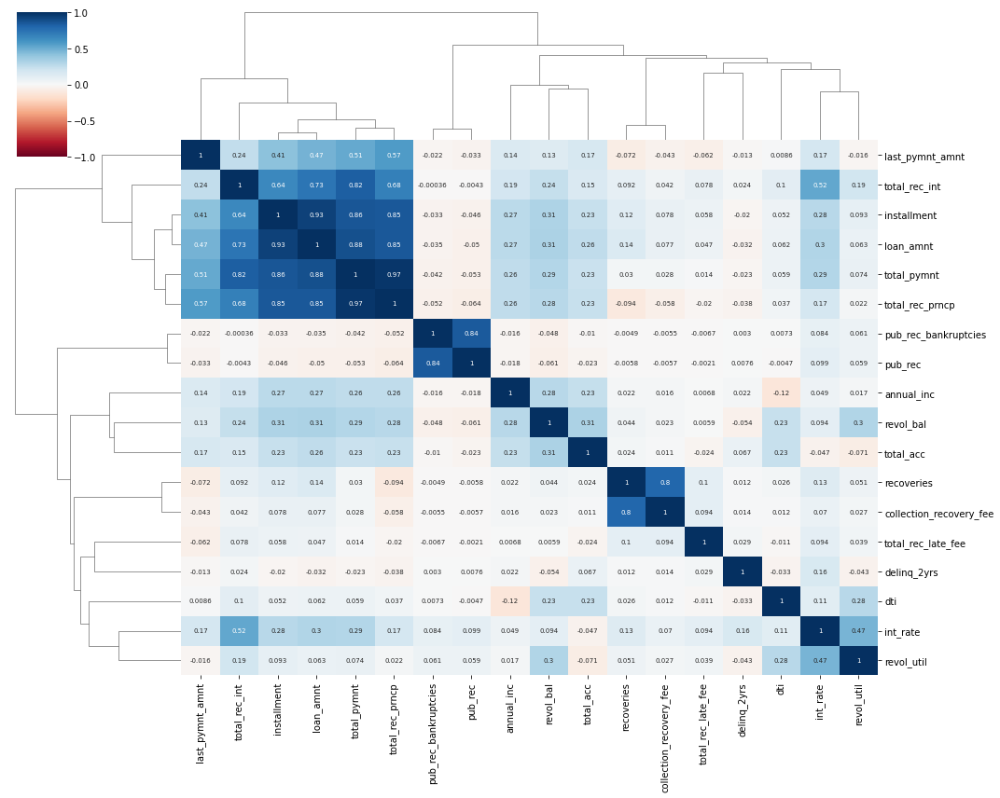

In [283]:
variables = ['int_rate', 'installment', 'annual_inc', 'dti', 'revol_util', 'total_pymnt', 
             'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 
             'collection_recovery_fee', 'last_pymnt_amnt', 'pub_rec_bankruptcies',
             'loan_amnt', 'delinq_2yrs', 'revol_bal', 'pub_rec', 'total_acc']
corrs = df[variables].corr()
sns.clustermap(corrs, method="complete", cmap='RdBu', annot=True, 
               annot_kws={"size": 7}, vmin=-1, vmax=1, figsize=(15,12));

It is interesting to see interest rate is decently correlated with revol_util (revolving credit line utilization). This could be because higher the utilization, lower would be the credit score.


In [281]:
df[variables].std().sort_values()

out_prncp                      0.000000
pub_rec_bankruptcies           0.202809
pub_rec                        0.237804
delinq_2yrs                    0.492271
int_rate                       3.691327
dti                            6.673044
total_rec_late_fee             7.315880
total_acc                     11.425861
revol_util                    28.346361
collection_recovery_fee      150.836853
installment                  208.639215
recoveries                   698.650182
total_rec_int               2389.499511
last_pymnt_amnt             4494.648131
total_rec_prncp             7009.381200
funded_amnt_inv             7022.720644
loan_amnt                   7348.441646
total_pymnt_inv             8700.845592
total_pymnt                 8809.856227
revol_bal                  15866.492241
annual_inc                 64218.681802
dtype: float64

In [279]:
dtypes = df.dtypes
print(dtypes[dtypes.isin([np.int32, np.int64, int])].index.tolist()) 
print(dtypes[dtypes.isin([float])].index.tolist())  #.astype(str).sort_values()

['loan_amnt', 'funded_amnt', 'term', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'total_acc']
['funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti', 'revol_util', 'out_prncp', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_amnt', 'pub_rec_bankruptcies']


In [284]:
fig = px.scatter(df, x='revol_util', y='int_rate')
fig.show()

As mentioned earlier, higher the revol_util, higher the rate of interest

In [286]:
fig = px.box(df, x='pub_rec_bankruptcies', y='loan_amnt')
fig.show()

Not often, higher loan amounts are sanctioned to those with bankruptcy records

Derive a new variable 'high_income' as those with more than half-a-million income and see if they are paying more?

In [290]:
df['very_high_income'] = np.where(df['annual_inc']>500000, 'yes', 'no')
income_vs_installment = df.groupby('very_high_income', as_index=False)['installment'].mean()
fig = px.bar(income_vs_installment, x='very_high_income', y='installment')
fig.show()